<div style="display: flex; justify-content: space-between; align-items: center; margin-bottom: 40px; margin-top: 0;">
    <div style="flex: 0 0 auto; margin-left: 0; margin-bottom: 0; margin-top: 0;">
        <img src="./pics/UCSD Logo.png" alt="UCSD Logo" style="width: 179px; margin-bottom: 0px; margin-top: 20px;">
    </div>
    <div style="flex: 0 0 auto; margin-left: auto; margin-bottom: 0; margin-top: 20px;">
        <img src="./pics/LANL-logo.png" alt="LANL Logo" style="width: 200px; margin-bottom: 0px;">
    </div>
    <div style="flex: 0 0 auto; margin-left: auto; margin-bottom: 0; margin-top: 20px;">
        <img src="./pics/prowess.png" alt="Prowess Logo" style="width: 200px; margin-bottom: 0px;">
    </div>
    <div style="flex: 0 0 auto; margin-left: auto; margin-bottom: 0; margin-top: 20px;">
        <img src="./pics/wildfire.png" alt="WildFire Logo" width="100"/>
    </div>
</div>

<h1 style="text-align: center; font-size: 48px; margin-top: 0;">Exploring ALS and TLS Point Clouds</h1>

**Team Name: Dry shRub** 

**Members:**

- Uzair Gheewala (ugheewala@ucsd.edu)
- Sean Harmon (t2harmon@ucsd.edu)

Following the `lidar_data.ipynb` notebook as a guide, select one ALS scan and one TLS scan from D.L. Bliss (different from the ones used in the instructional notebook). Describe the differences in the two datasets (e.g. extent, number of points, resolutions) and include at least 2 figures in the response. 

The following URLs are valid for use: 

**ALS**
* https://wifire-data.sdsc.edu/nc/public.php/dav/files/ucca-dl-bliss/ALS/USGS_LPC_CA_SierraNevada_B22_10SGJ5020.laz
* https://wifire-data.sdsc.edu/nc/public.php/dav/files/ucca-dl-bliss/ALS/USGS_LPC_CA_SierraNevada_B22_10SGJ5119.laz
* https://wifire-data.sdsc.edu/nc/public.php/dav/files/ucca-dl-bliss/ALS/USGS_LPC_CA_SierraNevada_B22_10SGJ5120.laz

**TLS**
* https://wifire-data.sdsc.edu/nc/public.php/dav/files/ucca-dl-bliss/original_TLS/CAAEU_0002_20250722_1.ptx
* https://wifire-data.sdsc.edu/nc/public.php/dav/files/ucca-dl-bliss/original_TLS/CAAEU_0003_20250722_1.ptx
* https://wifire-data.sdsc.edu/nc/public.php/dav/files/ucca-dl-bliss/original_TLS/CAAEU_0004_20250722_1.ptx
    
    


# Task
ALS dataset: https://wifire-data.sdsc.edu/nc/public.php/dav/files/ucca-dl-bliss/ALS/USGS_LPC_CA_SierraNevada_B22_10SGJ5120.laz  
TLS dataset: https://wifire-data.sdsc.edu/nc/public.php/dav/files/ucca-dl-bliss/original_TLS/CAAEU_0004_20250722_1.ptx  

## ALS

In [1]:
import requests
import laspy
from io import BytesIO

url_als = "https://wifire-data.sdsc.edu/nc/public.php/dav/files/ucca-dl-bliss/ALS/USGS_LPC_CA_SierraNevada_B22_10SGJ5120.laz"
res_als = requests.get(url_als)

buffer_als = BytesIO(res_als.content)

with laspy.open(buffer_als) as f:
    print(f"ALS Point Format - {f.header.point_format}")
    print(f"ALS Number of Points - {f.header.point_count}")
    print(f"Resolution: {f.header.scale}")

    points_als = f.read()

ALS Point Format - <PointFormat(6, 0 bytes of extra dims)>
ALS Number of Points - 11627486
Resolution: [0.01 0.01 0.01]


In [2]:
%pip install pyproj

Note: you may need to restart the kernel to use updated packages.


Resolution is 0.01m = 1cm

In [3]:
import pyproj
points_als.header.parse_crs()

<Compound CRS: COMPD_CS["NAD83(2011) / UTM zone 10N + NAVD88 heig ...>
Name: NAD83(2011) / UTM zone 10N + NAVD88 height - Geoid18 (m)
Axis Info [cartesian|vertical]:
- [east]: X (meter)
- [north]: Y (meter)
- [up]: Up (meter)
Area of Use:
- undefined
Datum: NAD83 (National Spatial Reference System 2011)
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich
Sub CRS:
- NAD83(2011) / UTM zone 10N
- NAVD88 height - Geoid18 (m)

In [4]:
list(points_als.point_format.dimension_names)

['X',
 'Y',
 'Z',
 'intensity',
 'return_number',
 'number_of_returns',
 'synthetic',
 'key_point',
 'withheld',
 'overlap',
 'scanner_channel',
 'scan_direction_flag',
 'edge_of_flight_line',
 'classification',
 'user_data',
 'scan_angle',
 'point_source_id',
 'gps_time']

In [5]:
x_als, y_als, z_als = points_als.x, points_als.y, points_als.z

print(x_als.shape, y_als.shape, z_als.shape)

(11627486,) (11627486,) (11627486,)


In [6]:
import plotly.graph_objects as go
import numpy as np

subset_size = 50000  # Number of points to sample

# We generate a set of random points
random_indices = np.random.choice(len(points_als.x), size=subset_size, replace=False)

# 2. We create an interactive 3D scatter plot
fig = go.Figure(data=[go.Scatter3d(
    x=x_als[random_indices],
    y=y_als[random_indices],
    z=z_als[random_indices],
    mode='markers',
    marker=dict(
        size=2,                     
        color=z_als[:subset_size],   # Color points by height (just to make it look nicer :D)
        colorscale='Viridis',        
        opacity=0.8                  
    )
)])

# 3. We add a few details and show the figure
fig.update_layout(
    title="Airborne Laser Scanning (ALS) Point Cloud",
    scene=dict(
        xaxis_title="X (m)",
        yaxis_title="Y (m)",
        zaxis_title="Z (m)"
    ),
    margin=dict(l=0, r=0, b=0, t=40)  
)

fig.show()

It looks like there are some trees on a small hill

## TLS

In [7]:
from pathlib import Path
import subprocess

# URL of the PTX file
ptx_url = "https://wifire-data.sdsc.edu/nc/public.php/dav/files/ucca-dl-bliss/original_TLS/CAAEU_0004_20250722_1.ptx"

# Filenames - You can replace these names
ptx_file = Path("input.ptx")
laz_file = Path("output.laz")

# 1. We request and download the .ptx file locally
res = requests.get(ptx_url)

with ptx_file.open("wb") as f:
    f.write(res.content)

print(f"Downloaded PTX file: {ptx_file}")

# 2. We convert the .ptx file to .laz using PDAL
pdal_command = ["pdal", "translate", str(ptx_file), str(laz_file)]
result = subprocess.run(pdal_command, capture_output=True, text=True)

# This is a check in case there is some error with the transformation
if result.returncode == 0:
    print(f"Converted {ptx_file} to {laz_file}")
else:
    print(f"PDAL translation failed: {result.stderr}")
    raise RuntimeError(f"PDAL translation error: {result.stderr}")

# 3. We delete the original .ptx file
ptx_file.unlink()
print(f"Deleted original PTX file: {ptx_file}")

Downloaded PTX file: input.ptx
Converted input.ptx to output.laz
Deleted original PTX file: input.ptx


In [8]:
# Read the .las file using Laspy
with laspy.open(laz_file) as tls_file:
    print(f"Point Format: {tls_file.header.point_format}")
    print(f"Number of Points: {tls_file.header.point_count}")
    print(f"Resolution: {tls_file.header.scale}")

    # Read all points from the LAZ file
    points_tls = tls_file.read()
    list(points_tls.point_format.dimension_names)

Point Format: <PointFormat(3, 0 bytes of extra dims)>
Number of Points: 7784154
Resolution: [0.01 0.01 0.01]


This TLS only has point format = 3, compared to ALS point format = 6

Resolution is 0.01m = 1cm

In [9]:
points_tls.header.parse_crs()

In [10]:
# Now we can remove the .laz file
laz_file.unlink()
print(f"Deleted original LAZ file: {laz_file}")

Deleted original LAZ file: output.laz


In [11]:
list(points_tls.point_format.dimension_names)

['X',
 'Y',
 'Z',
 'intensity',
 'return_number',
 'number_of_returns',
 'scan_direction_flag',
 'edge_of_flight_line',
 'classification',
 'synthetic',
 'key_point',
 'withheld',
 'scan_angle_rank',
 'user_data',
 'point_source_id',
 'gps_time',
 'red',
 'green',
 'blue']

In [12]:
r_tls, g_tls, b_tls = points_tls.red, points_tls.green, points_tls.blue

print(r_tls.shape, g_tls.shape, b_tls.shape)

(7784154,) (7784154,) (7784154,)


In [13]:
with ptx_file.open("wb") as f:
    f.write(res.content)

n_header = 10 # Number of rows in the header

tls_ptx = np.loadtxt('input.ptx', skiprows=n_header)
tls_ptx = tls_ptx[~np.all(tls_ptx == 0, axis=1)]
print(tls_ptx.shape)

ptx_file.unlink()

(7784154, 7)


In [14]:
subset_size = 50000  # Number of points to sample

# We generate a set of random points
random_indices = np.random.choice(len(points_tls.x), size=subset_size, replace=False)

# Use the random indices to select points
fig = go.Figure(data=[go.Scatter3d(
    x=points_tls.x[random_indices],
    y=points_tls.y[random_indices],
    z=points_tls.z[random_indices],
    mode='markers',
    marker=dict(
        size=2,
        color=r_tls[random_indices],  # Let's use red as the scale for our colors
        colorscale='Reds',
        opacity=0.8
    )
)])

fig.update_layout(
    title="3D Point Cloud Visualization (LAZ Data)",
    scene=dict(
        xaxis_title="X (m)",
        yaxis_title="Y (m)",
        zaxis_title="Z (m)"
    ),
    margin=dict(l=0, r=0, b=0, t=40)  
)

# Display the plot
fig.show()

It looks like a forest on an incline.

# Comparison

### Points  
The ALS dataset has 11,627,486 points in point format 6, while the TLS dataset has 7,784,154 points in point format 3.  

### Attributes
The ALS dataset supports point format 6 and the following attributes:    
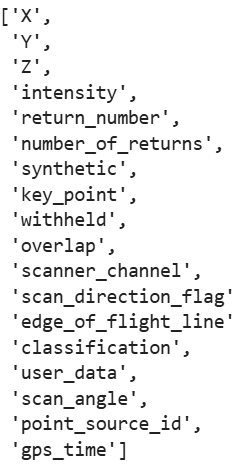  

While the TLS supports point format 3 and the following attributes:  
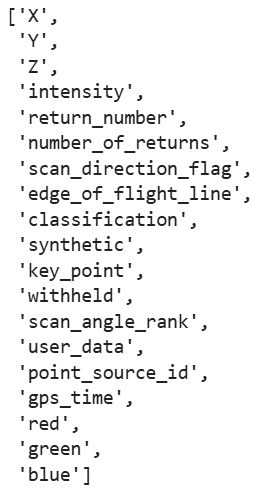

In [15]:
set(points_tls.point_format.dimension_names) - set(points_als.point_format.dimension_names)

{'blue', 'green', 'red', 'scan_angle_rank'}

In [16]:
set(points_als.point_format.dimension_names) - set(points_tls.point_format.dimension_names)

{'overlap', 'scan_angle', 'scanner_channel'}

Notably, the ALS data supports overlap, scan angle and scanner channel attributes, while the TLS data supports RGB colors and scan angle rank attributes.  
All other attributes are the same

### Points Clouds  
**ALS**  
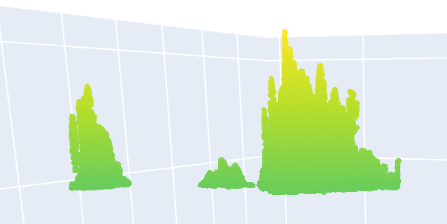    
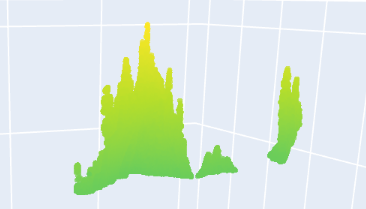  
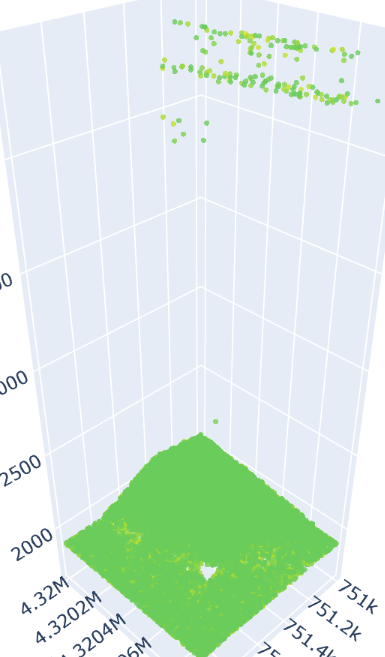  
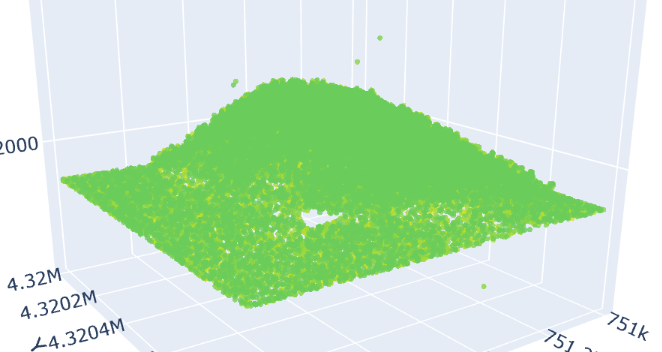  
  
**TLS**  
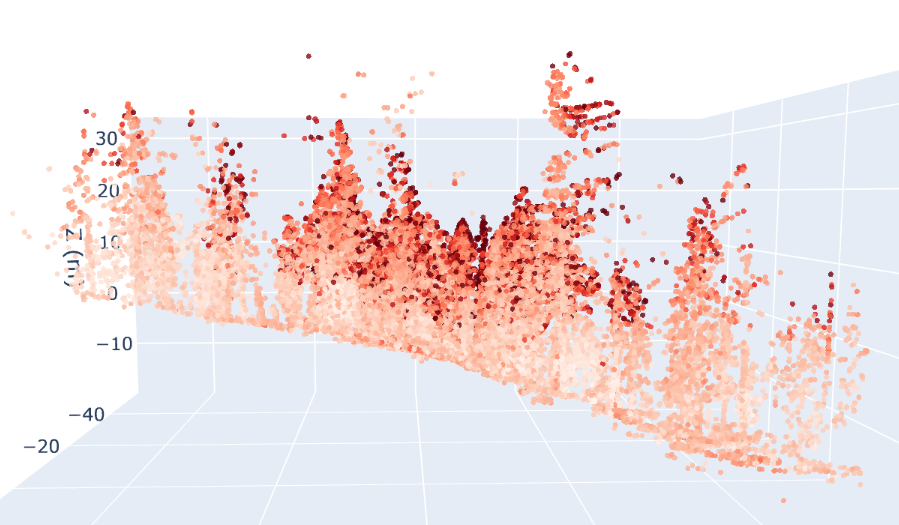  
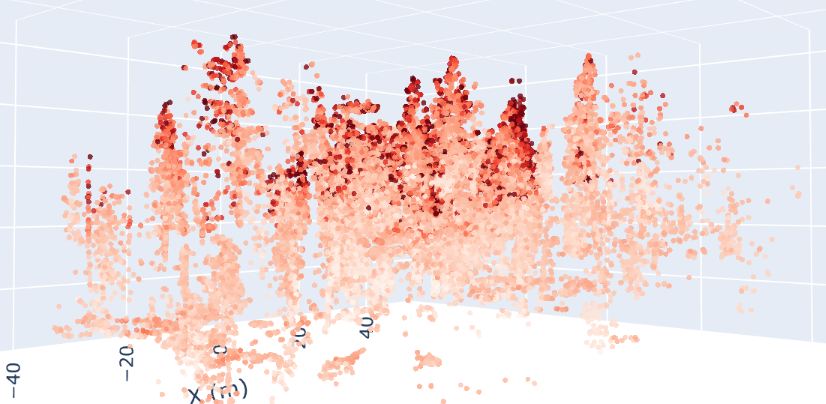  

The ALS point cloud captures trees on a short, narrow hill high above some flat plain. Compared to the TLS point cloud, which shows a denser forest on a hill with a slight incline. The ALS point cloud encompasses a larger, less dense area, while the TLS point cloud hones in on a specific forest segment.

It is apparent that the ALS point cloud produces more precise outlines of the terrain. 

### Resolution  
Both the ALS and TLS datasets use a resolution of 1cm for xyz dimensions.